In [1]:
import os
os.chdir('..')
import sys
sys.path.append('../code')

In [2]:

import argparse
import GPUtil
# import os
from pyhocon import ConfigFactory
import torch
import numpy as np
from PIL import Image
from tqdm import tqdm
import pandas as pd

import utils.general as utils
import utils.plots as plots
from utils import rend_util
import matplotlib.pyplot as plt 

from collections import defaultdict
import trimesh
import cv2
# from cv2.line_descriptor import BinaryDescriptor_createBinaryDescriptor as LBD
# from cv2 import line_descriptor_KeyLine as KeyLine

import kornia
import torch

In [3]:
def epiline2xyxy(epiline, w,h):
    n = epiline.shape[0]
    y0 = -epiline[:,2]/epiline[:,1]
    x0 = y0*0
    y1 = -(epiline[:,2] + epiline[:,0]*w)/epiline[:,1]
    x1 = x0 + w
    xyxy = torch.stack((x0,y0,x1,y1),dim=-1)
    return xyxy

In [4]:
def get_cam(c2w_):
    if isinstance(c2w_, torch.Tensor):
        c2w = c2w_.cpu().numpy()
    else:
        c2w = c2w_

    center = c2w[:3,3]
    x = c2w[:3,0]*0.1
    y = c2w[:3,1]*0.1
    z = c2w[:3,2]*0.1

    tz = trimesh.load_path(np.stack((center,center+z),axis=0))
    tz.colors = np.array([[255,0,0]])
    ty = trimesh.load_path(np.stack((center,center+y),axis=0))
    ty.colors = np.array([[0,255,0]])
    tx = trimesh.load_path(np.stack((center,center+x),axis=0))
    tx.colors = np.array([[0,0,255]])

    cam = trimesh.Scene([tx,ty,tz])

    
    return cam


In [5]:
def get_kwargs(**kwargs):
    return kwargs

In [6]:
opt = argparse.Namespace(conf='confs/dtu-hat.conf', 
                          expname='', 
                          exps_folder='exps', 
                          evals_folder='evals', 
                          gpu='auto', 
                          timestamp='latest', 
                          checkpoint='2000', scan_id=24, resolution=512, eval_rendering=False)




In [7]:
kwargs = get_kwargs(conf=opt.conf,
        expname=opt.expname,
        exps_folder_name=opt.exps_folder,
        evals_folder_name=opt.evals_folder,
        timestamp=opt.timestamp,
        checkpoint=opt.checkpoint,
        scan_id=opt.scan_id,
        resolution=opt.resolution,
        eval_rendering=opt.eval_rendering,)

In [8]:
conf = ConfigFactory.parse_file(kwargs['conf'])
exps_folder_name = kwargs['exps_folder_name']
evals_folder_name = kwargs['evals_folder_name']
eval_rendering = kwargs['eval_rendering']

In [9]:
expname = conf.get_string('train.expname') + kwargs['expname']
scan_id = kwargs['scan_id'] if kwargs['scan_id'] != -1 else conf.get_int('dataset.scan_id', default=-1)
if scan_id != -1:
    expname = expname + '_{0}'.format(scan_id)

if kwargs['timestamp'] == 'latest':
    if os.path.exists(os.path.join('../', kwargs['exps_folder_name'], expname)):
        timestamps = os.listdir(os.path.join('../', kwargs['exps_folder_name'], expname))
        if (len(timestamps)) == 0:
            print('WRONG EXP FOLDER')
            exit()
        # self.timestamp = sorted(timestamps)[-1]
        timestamp = None
        for t in sorted(timestamps):
            if os.path.exists(os.path.join('../', kwargs['exps_folder_name'], expname, t, 'checkpoints',
                                           'ModelParameters', str(kwargs['checkpoint']) + ".pth")):
                timestamp = t
        if timestamp is None:
            print('NO GOOD TIMSTAMP')
            exit()
    else:
        print('WRONG EXP FOLDER')
        exit()
else:
    timestamp = kwargs['timestamp']


utils.mkdir_ifnotexists(os.path.join('../', evals_folder_name))
expdir = os.path.join('../', exps_folder_name, expname)
evaldir = os.path.join('../', evals_folder_name, expname)
outdir = os.path.join('../', evals_folder_name, expname,'outputs')
utils.mkdir_ifnotexists(evaldir)
utils.mkdir_ifnotexists(outdir)

dataset_conf = conf.get_config('dataset')
if kwargs['scan_id'] != -1:
    dataset_conf['scan_id'] = kwargs['scan_id']
eval_dataset = utils.get_class(conf.get_string('train.dataset_class'))(**dataset_conf)

conf_model = conf.get_config('model')
model = utils.get_class(conf.get_string('train.model_class'))(conf=conf_model)
if torch.cuda.is_available():
    model.cuda()


In [10]:
total_pixels = eval_dataset.total_pixels
img_res = eval_dataset.img_res

In [11]:
eval_dataloader = torch.utils.data.DataLoader(eval_dataset,
                                                  batch_size=1,
                                                  shuffle=False,
                                                  collate_fn=eval_dataset.collate_fn
                                                  )

In [12]:
wireframes = []
poses = []
K = []
rgb = []

cameras = []

for data_index, (indices, model_input, ground_truth) in enumerate(eval_dataloader):
    # model_input["intrinsics"] = model_input["intrinsics"].cuda()
    # model_input["uv"] = model_input["uv"].cuda()
    # model_input['pose'] = model_input['pose'].cuda()
    rgb.append(ground_truth['rgb'].reshape(*img_res,-1))
    wireframe = model_input['wireframe']

    wireframes.append(wireframe[0])
    poses.append(model_input['pose'])
    K.append(model_input['intrinsics'])

    cameras.append(get_cam(model_input['pose'][0]))

mesh = trimesh.load_mesh('/home/xn/repo/hawp2vision/volsdf/exps/dtu_24/2022_09_08_14_12_26/plots/surface_2000.ply')

In [13]:
trimesh.Scene([cameras[:2],mesh]).show()

In [14]:
projections = [p.inverse()[:,:3] for p in poses]

## Correspondences between Cam0 and Cam1

### Line Detection Results

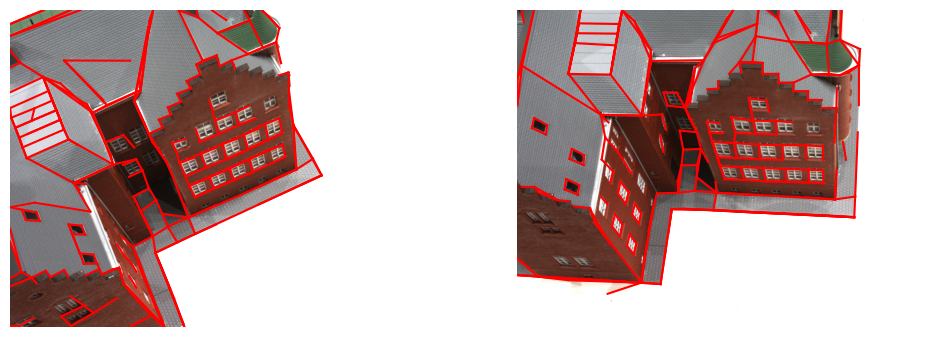

In [15]:
lines1 = wireframes[0].line_segments(0.05).numpy()
lines2 = wireframes[1].line_segments(0.05).numpy()

img1 = np.array(rgb[0].numpy()*255,dtype=np.uint8)
img2 = np.array(rgb[1].numpy()*255,dtype=np.uint8)
fig, ax = plt.subplots(figsize=(12,18),nrows=1,ncols=2)
ax[0].imshow(img1)
ax[0].plot([lines1[:,0],lines1[:,2]],[lines1[:,1],lines1[:,3]],'r-')
ax[0].axis('off')
ax[1].imshow(img2)
ax[1].plot([lines2[:,0],lines2[:,2]],[lines2[:,1],lines2[:,3]],'r-')
ax[1].axis('off')
plt.show()

### Camera Pose Preparation

In [16]:
P0w = projections[0]
P1w = projections[1]
# P0w = poses[0]
# P1w = poses[1]
K0 = K[0][:,:3,:3]
K1 = K[1][:,:3,:3]

I = torch.eye(3)[None]
O = torch.zeros((1,3,1))

In [17]:
R, T = kornia.geometry.epipolar.relative_camera_motion(P0w[:,:3,:3],P0w[:,:3,3:],P1w[:,:3,:3],P1w[:,:3,3:])

In [18]:
E = kornia.geometry.epipolar.essential_from_Rt(I,O,R,T)

In [19]:
F = kornia.geometry.epipolar.fundamental_from_essential(E,K0,K1)

### Junction/Point Detection Results

In [20]:
wireframe0 = wireframes[0]
wireframe1 = wireframes[1]

points0 = wireframe0.vertices
points1 = wireframe1.vertices

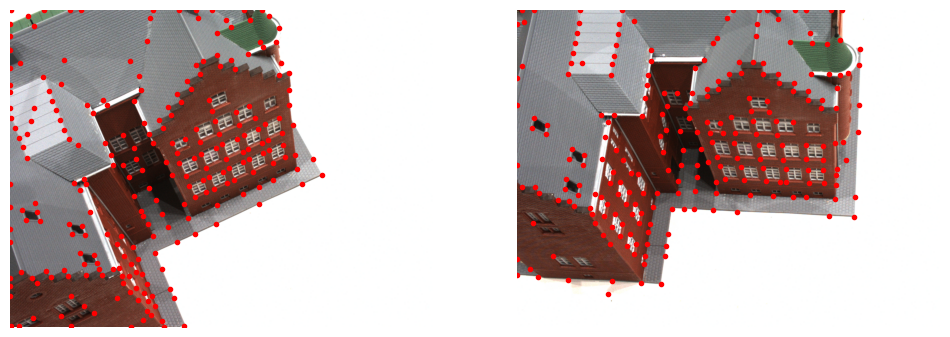

In [21]:
img1 = np.array(rgb[0].numpy()*255,dtype=np.uint8)
img2 = np.array(rgb[1].numpy()*255,dtype=np.uint8)
fig, ax = plt.subplots(figsize=(12,18),nrows=1,ncols=2)
ax[0].imshow(img1)
ax[0].plot(points0[:,0].numpy(),points0[:,1].numpy(),'r.')
ax[0].axis('off')
ax[1].imshow(img2)
ax[1].plot(points1[:,0].numpy(),points1[:,1].numpy(),'r.')
ax[1].axis('off')
plt.show()

### Epiploar Lines

In [22]:
epiline0 = kornia.geometry.epipolar.compute_correspond_epilines(points0[None], F)[0]
epiline1 = kornia.geometry.epipolar.compute_correspond_epilines(points1[None], F.transpose(1,2))[0]



In [23]:
ep0_xyxy = epiline2xyxy(epiline0,w=img_res[1],h=img_res[0])
ep1_xyxy = epiline2xyxy(epiline1,w=img_res[1],h=img_res[0])

In [24]:
ep0_xyxy.shape

torch.Size([244, 4])

(1200.0, 0.0)

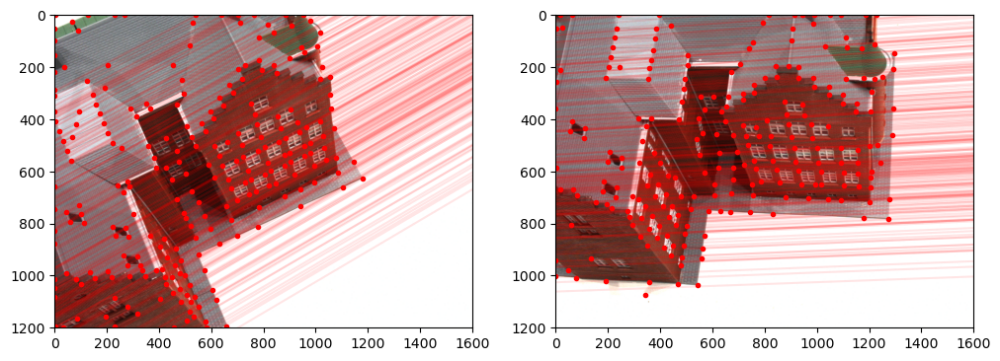

In [25]:
fig, ax = plt.subplots(figsize=(12,18),nrows=1,ncols=2)
ax[0].imshow(img1)
ax[0].plot([ep1_xyxy[:,0].numpy(),ep1_xyxy[:,2].numpy()],[ep1_xyxy[:,1].numpy(),ep1_xyxy[:,3].numpy()],'r-',alpha=0.1)
ax[0].plot(points0[:,0].numpy(),points0[:,1].numpy(),'r.')
ax[0].set_xlim(0,img_res[1])
ax[0].set_ylim(img_res[0],0)
ax[1].imshow(img2)
ax[1].plot([ep0_xyxy[:,0].numpy(),ep0_xyxy[:,2].numpy()],[ep0_xyxy[:,1].numpy(),ep0_xyxy[:,3].numpy()],'r-',alpha=0.1)
ax[1].plot(points1[:,0].numpy(),points1[:,1].numpy(),'r.')
ax[1].set_xlim(0,img_res[1])
ax[1].set_ylim(img_res[0],0)

### Compute Epipolar Distances

In [26]:
dist0 = torch.abs(
        epiline0[:,None,0]*points1[None,:,0]+epiline0[:,None,1]*points1[None,:,1]+epiline0[:,None,2])

In [27]:
dist1 = torch.abs(
        epiline1[:,None,0]*points0[None,:,0]+epiline1[:,None,1]*points0[None,:,1]+epiline1[:,None,2])

dist0 = 0.5*(dist0+dist1.t())

In [28]:
d0, i0 = dist0.topk(k=5,dim=1,largest=False)

(1200.0, 0.0)

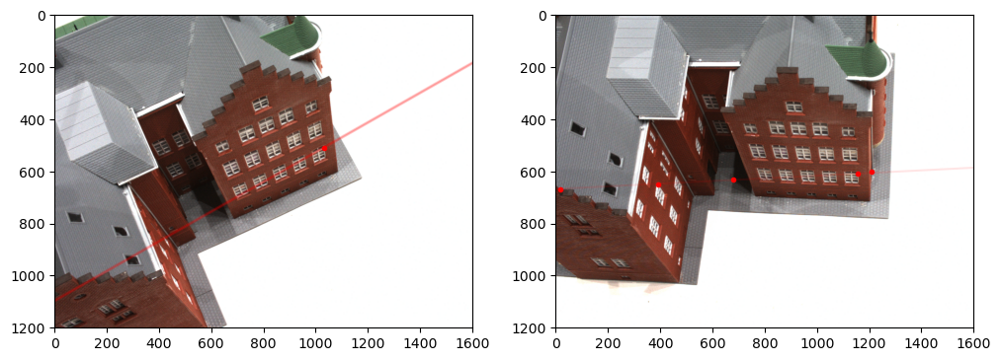

In [29]:
jd0 = np.random.choice(d0.shape[0],1)

jd1 = i0[jd0].flatten()

fig, ax = plt.subplots(figsize=(12,18),nrows=1,ncols=2)
ax[0].imshow(img1)
ax[0].plot([ep1_xyxy[jd1,0].numpy(),ep1_xyxy[jd1,2].numpy()],[ep1_xyxy[jd1,1].numpy(),ep1_xyxy[jd1,3].numpy()],'r-',alpha=0.1)
ax[0].plot(points0[jd0,0].numpy(),points0[jd0,1].numpy(),'r.')
ax[0].set_xlim(0,img_res[1])
ax[0].set_ylim(img_res[0],0)
ax[1].imshow(img2)
ax[1].plot([ep0_xyxy[jd0,0].numpy(),ep0_xyxy[jd0,2].numpy()],[ep0_xyxy[jd0,1].numpy(),ep0_xyxy[jd0,3].numpy()],'r-',alpha=0.1)
ax[1].plot(points1[jd1,0].numpy(),points1[jd1,1].numpy(),'r.')
ax[1].set_xlim(0,img_res[1])
ax[1].set_ylim(img_res[0],0)

In [30]:
id0, id1 = (dist0<1).nonzero(as_tuple=True)

In [31]:
x0 = points0[id0]
x1 = points1[id1]

In [32]:
X = kornia.geometry.epipolar.triangulate_points(
    K0@torch.cat((I,O),dim=-1),
    K1@torch.cat((R,T),dim=-1),
    x0[None],
    x1[None]
)[0]

In [33]:
Xw = (poses[0][0,:3,:3]@X.t()+poses[0][0,:3,3:]).t()

In [34]:
mask = (X[:,-1]>0)*(X[:,-1]<3)

In [35]:
pc = trimesh.points.PointCloud(Xw[mask].cpu().numpy(),colors=np.tile(np.array([0, 0, 0, 1]), (sum(mask), 1)))

In [36]:
trimesh.Scene([mesh,pc,cameras[0]]).show()

In [37]:
x0r = (K0[0]@X.t()).t()
x0r = x0r[:,:2]/x0r[:,2:]

In [38]:
x1r = (K0[0]@(R[0]@X.t()+T[0])).t()
x1r = x1r[:,:2]/x1r[:,2:]

In [39]:
err1 = (torch.sum((x0r - x0)**2,dim=-1).sqrt())
err2 = (torch.sum((x1r - x1)**2,dim=-1).sqrt())
err_sum = 0.5*(err1+err2)

In [40]:
mask = mask*(err_sum<2.0)

In [41]:
pc = trimesh.points.PointCloud(Xw[mask].cpu().numpy(),colors=np.tile(np.array([0, 0, 0, 1]), (sum(mask), 1)))

In [42]:
trimesh.Scene([mesh,pc,cameras[0]]).show()

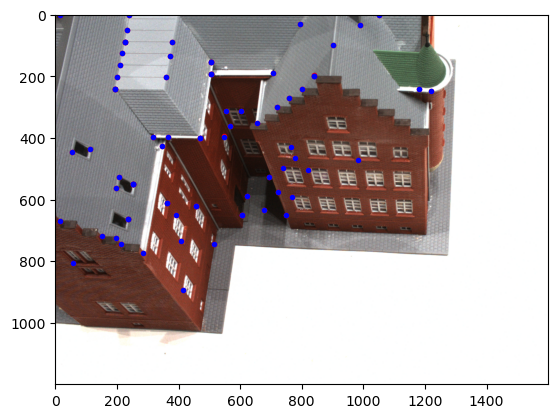

In [43]:
plt.imshow(img2)
plt.plot(x1r[mask,0].numpy(),x1r[mask,1].numpy(),'r.')
plt.plot(x1[mask,0].numpy(),x1[mask,1].numpy(),'b.')

In [44]:
x1r.shape

torch.Size([143, 2])

### With HyNet

In [45]:
HyNet = kornia.feature.HyNet(pretrained=True)

In [46]:
import torchvision

In [47]:
torchvision.transforms.Grayscale()

Grayscale(num_output_channels=1)

In [48]:
def rgb2gray(tensor):
    assert isinstance(tensor,torch.Tensor)
    nparray = np.array(tensor*255,dtype=np.uint8)
    gray = cv2.cvtColor(nparray,cv2.COLOR_RGB2GRAY)
    gray = np.array(gray,dtype=np.float32)/255.0
    return torch.tensor(gray)

In [49]:
def patch_sample(grayim, points, w, h):
    
    xm,ym = torch.meshgrid(torch.arange(-16,16),torch.arange(-16,16),indexing='xy')
    xm = xm.reshape(1,-1)
    ym = ym.reshape(1,-1)
    
    xl = points.long()[:,None,0] + xm
    yl = points.long()[:,None,1] + ym
    
    mask = (xl>=0)*(xl<w)*(yl>=0)*(yl<h)
    
    xl = xl.clamp(0,w-1)
    yl = yl.clamp(0,h-1)
    
    patches = grayim[yl,xl]
#     return torch.stack((xl,yl),dim=-1)
#     print(xl)
    return patches.reshape(-1,32,32)

In [50]:
gray0 = rgb2gray(rgb[0])
gray1 = rgb2gray(rgb[1])

In [51]:
np.arange(-16,16).shape

(32,)

In [52]:
patches0 = patch_sample(gray0,points0,img_res[1],img_res[0])
patches1 = patch_sample(gray1,points1,img_res[1],img_res[0])

In [53]:
with torch.no_grad():
    desc0 = HyNet(patches0[:,None])
    desc1 = HyNet(patches1[:,None])

In [54]:
ddis = torch.sum((desc0[:,None] - desc1[None])**2,dim=-1)

In [55]:
mdis, midx = ddis.topk(k=2,largest=False,dim=1)

In [56]:
dmask = (mdis[:,0]<mdis[:,1]*0.95)

In [57]:
x0 = points0[dmask]

In [58]:
x1 = points1[midx[dmask,0]]

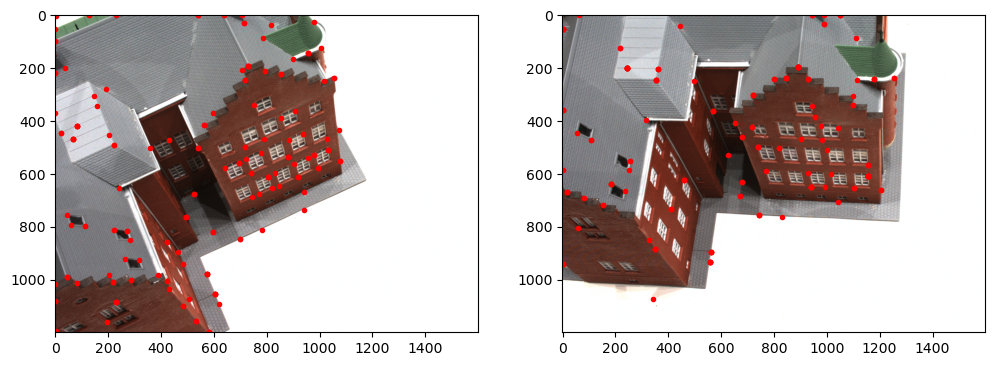

In [59]:
rand_id = np.random.choice(x0.shape[0],x0.shape[0])

fig, ax = plt.subplots(1,2, figsize=(12,18))

ax[0].imshow(img1)
ax[0].plot(x0[rand_id,0].numpy(),x0[rand_id,1].numpy(),'r.')

ax[1].imshow(img2)
ax[1].plot(x1[rand_id,0].numpy(),x1[rand_id,1].numpy(),'r.')



In [60]:
epiline0 = kornia.geometry.epipolar.compute_correspond_epilines(x0[None], F)[0]
epiline1 = kornia.geometry.epipolar.compute_correspond_epilines(x1[None], F.transpose(1,2))[0]


In [61]:
emask = kornia.geometry.epipolar.symmetrical_epipolar_distance(x0[None],x1[None],F,squared=False)<5

In [62]:
x0e = x0[emask[0]]
x1e = x1[emask[0]]

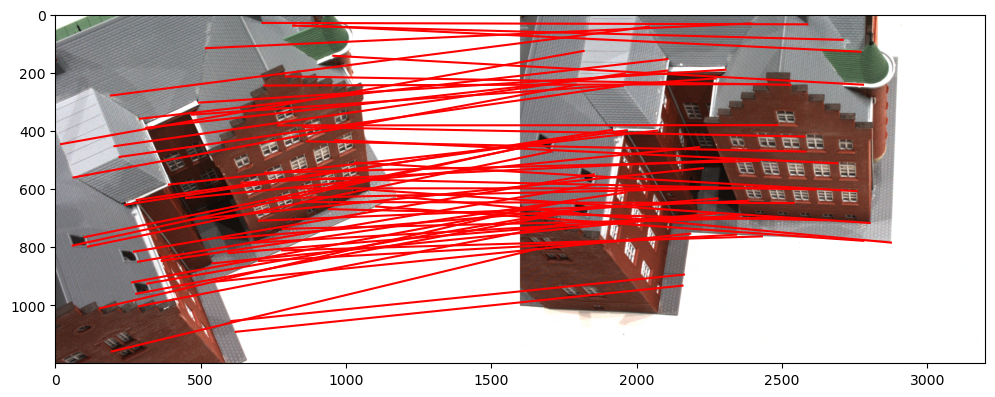

In [63]:
plt.figure(figsize=(12,18))
plt.imshow(np.concatenate((img1,img2),axis=1))
_ = plt.plot(
    [x0e[:,0].numpy(),x1e[:,0].numpy()+img_res[1]],
    [x0e[:,1].numpy(),x1e[:,1].numpy()],
    'r-'
)

In [64]:
X = kornia.geometry.epipolar.triangulate_points(
    K0@torch.cat((I,O),dim=-1),
    K1@torch.cat((R,T),dim=-1),
    x0e[None],
    x1e[None]
)[0]

In [65]:
Xw = (poses[0][0,:3,:3]@X.t()+poses[0][0,:3,3:]).t()

In [66]:
x0r = (K0[0]@X.t()).t()
x0r = x0r[:,:2]/x0r[:,2:]

In [67]:
x1r = (K0[0]@(R[0]@X.t()+T[0])).t()
x1r = x1r[:,:2]/x1r[:,2:]

In [68]:
err1 = (torch.sum((x0r - x0e)**2,dim=-1).sqrt())
err2 = (torch.sum((x1r - x1e)**2,dim=-1).sqrt())
err_sum = 0.5*(err1+err2)

In [69]:
err_sum

tensor([0.3577, 1.0321, 0.4306, 0.5060, 0.4992, 0.8378, 0.2958, 1.6531, 0.3409,
        1.2143, 0.0784, 0.1137, 0.2340, 0.3390, 1.1432, 0.4028, 0.5640, 1.0212,
        0.4167, 0.6655, 1.2846, 0.7856, 0.8279, 0.2856, 1.3245, 0.3377, 0.7922,
        0.1331, 1.0340, 1.5181, 1.5123, 0.3142, 0.0802, 0.8121, 1.2646, 1.3027,
        0.3769, 0.2394, 0.9856, 0.8336, 0.6597, 0.1824, 0.0972, 0.7252, 0.1914,
        0.4778, 0.3695, 0.0201, 1.0841, 0.2368, 1.5911, 0.0839, 1.1562, 0.4003,
        0.0541, 1.5162, 0.8159, 0.9910, 1.5872])

In [72]:
pc = trimesh.points.PointCloud(Xw.cpu().numpy(),colors=np.tile(np.array([255, 255, 0,]), (sum(mask), 1)))

In [74]:
trimesh.Scene([pc,cameras[0]]).show()